In [1]:
import os
import cv2
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
import plotly.express as px
import plotly.graph_objects as go
import seaborn as sns
from sklearn.model_selection import train_test_split

In [2]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [3]:
os.environ['WANDB_MODE'] = 'disabled'

In [4]:
# Paths
train_img_path = "/content/drive/My Drive/Datasets/craters"
train_img_path = "/content/drive/My Drive/Datasets/craters/train/images/"
train_lbl_path = "/content/drive/My Drive/Datasets/craters/train/labels/"
valid_img_path = "/content/drive/My Drive/Datasets/craters/valid/images/"
valid_lbl_path = "/content/drive/My Drive/Datasets/craters/valid/labels/"
test_img_path = "/content/drive/My Drive/Datasets/craters/test/images/"
test_lbl_path = "/content/drive/My Drive/Datasets/craters/test/labels/"
model_path = "/content/drive/My Drive/Datasets/craters/best.pt"
data_yaml_path = "/content/drive/My Drive/Datasets/craters/data.yaml"

In [5]:
# EDA and Data Preprocessing
def load_labels(label_path):
    label_files = os.listdir(label_path)
    data = []
    classes = set()
    for file in label_files:
        with open(os.path.join(label_path, file), 'r') as f:
            lines = f.readlines()
            for line in lines:
                parts = list(map(float, line.strip().split()))
                data.append([file, *parts])
                classes.add(int(parts[0]))
    df = pd.DataFrame(data, columns=['file', 'class', 'x_center', 'y_center', 'width', 'height'])
    return df, sorted(classes)

train_labels, train_classes = load_labels(train_lbl_path)
valid_labels, valid_classes = load_labels(valid_lbl_path)
test_labels, test_classes = load_labels(test_lbl_path)

In [6]:
# Get all unique classes
all_classes = sorted(set(train_classes + valid_classes + test_classes))
class_names = [f'class_{i}' for i in all_classes]

In [7]:
# Display first few rows of the labels
print("Train Labels")
print(train_labels.head())
print("\nValidation Labels")
print(valid_labels.head())
print("\nTest Labels")
print(test_labels.head())

Train Labels
                                                file  class  x_center  \
0  mars_crater--41-_jpg.rf.5b367c681ccf0dfa9c5fdd...    0.0  0.446875   
1  mars_crater--14-_jpg.rf.e050bff73578e2a9ad30e3...    0.0  0.536719   
2  mars_crater--14-_jpg.rf.e050bff73578e2a9ad30e3...    0.0  0.418750   
3    017_png.rf.1504c0d3ecbf20af6bc5114ca197a0dd.txt    0.0  0.854688   
4    017_png.rf.1504c0d3ecbf20af6bc5114ca197a0dd.txt    0.0  0.344531   

   y_center     width    height  
0  0.516406  0.854688  0.964844  
1  0.657813  0.163281  0.216406  
2  0.124219  0.042969  0.053125  
3  0.610156  0.279687  0.262500  
4  0.062500  0.128125  0.115625  

Validation Labels
                                                file  class  x_center  \
0  mars_crater--1-_png.rf.f1b399f95708fd0ce520f23...    0.0  0.835156   
1  mars_crater--1-_png.rf.f1b399f95708fd0ce520f23...    0.0  0.470313   
2  mars_crater--1-_png.rf.f1b399f95708fd0ce520f23...    0.0  0.767188   
3  mars_crater--1-_png.rf.f1b399f

In [8]:
# Create data.yaml
data_yaml_content = f"""
train: {train_img_path}
val: {valid_img_path}
test: {test_img_path}

nc: {len(all_classes)}  # number of classes
names: {class_names}  # class names
"""

with open(data_yaml_path, 'w') as f:
    f.write(data_yaml_content)

In [9]:
# Plotting distribution of bounding box sizes
def plot_bounding_box_distribution(labels, title):
    labels['area'] = labels['width'] * labels['height']
    fig = px.histogram(labels, x='area', nbins=50, title=title)
    fig.show()

plot_bounding_box_distribution(train_labels, 'Train Bounding Box Area Distribution')
plot_bounding_box_distribution(valid_labels, 'Validation Bounding Box Area Distribution')
plot_bounding_box_distribution(test_labels, 'Test Bounding Box Area Distribution')

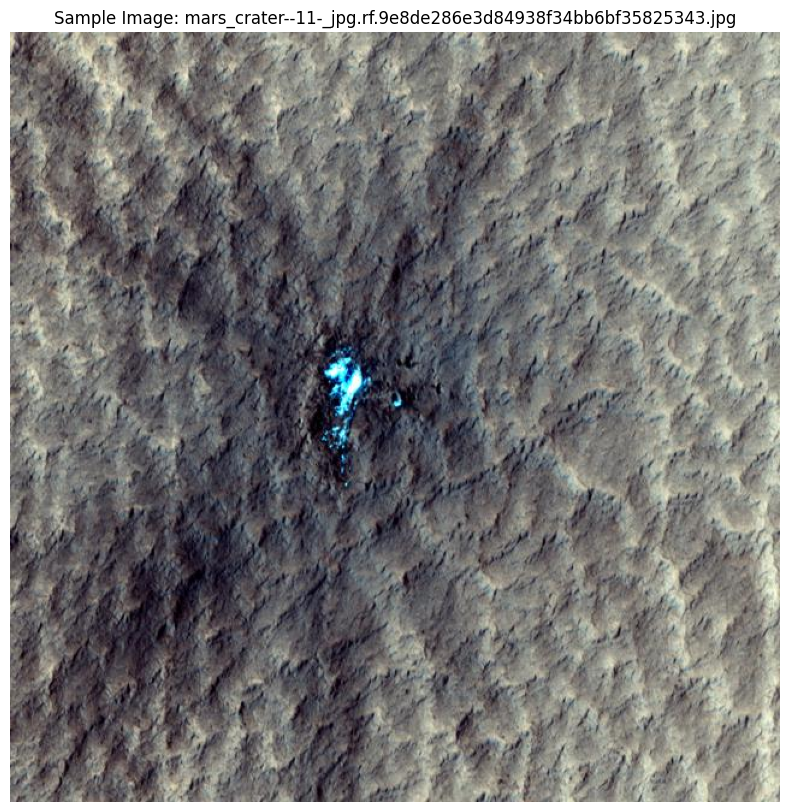

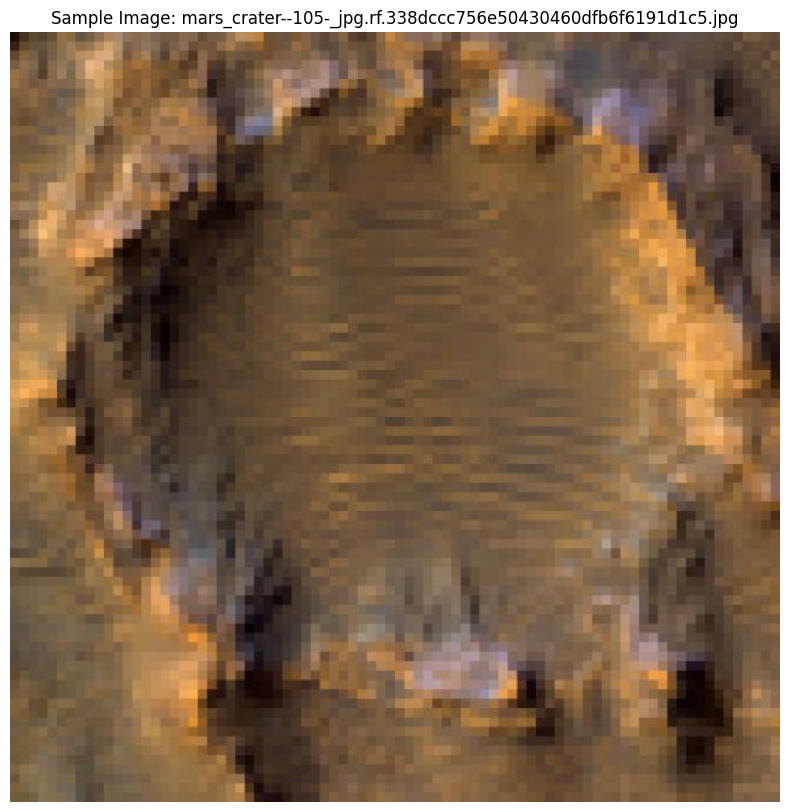

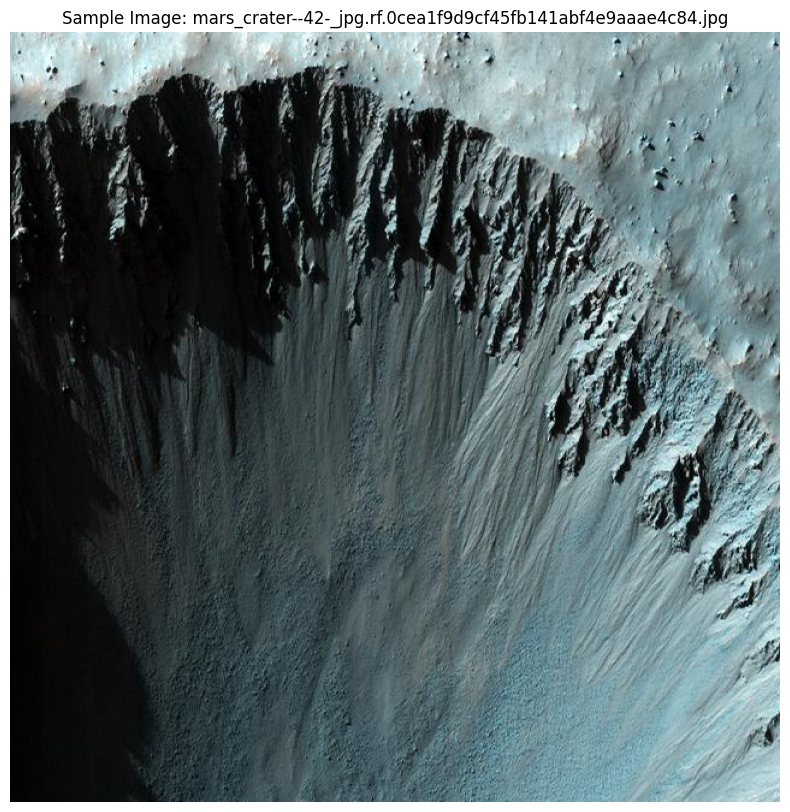

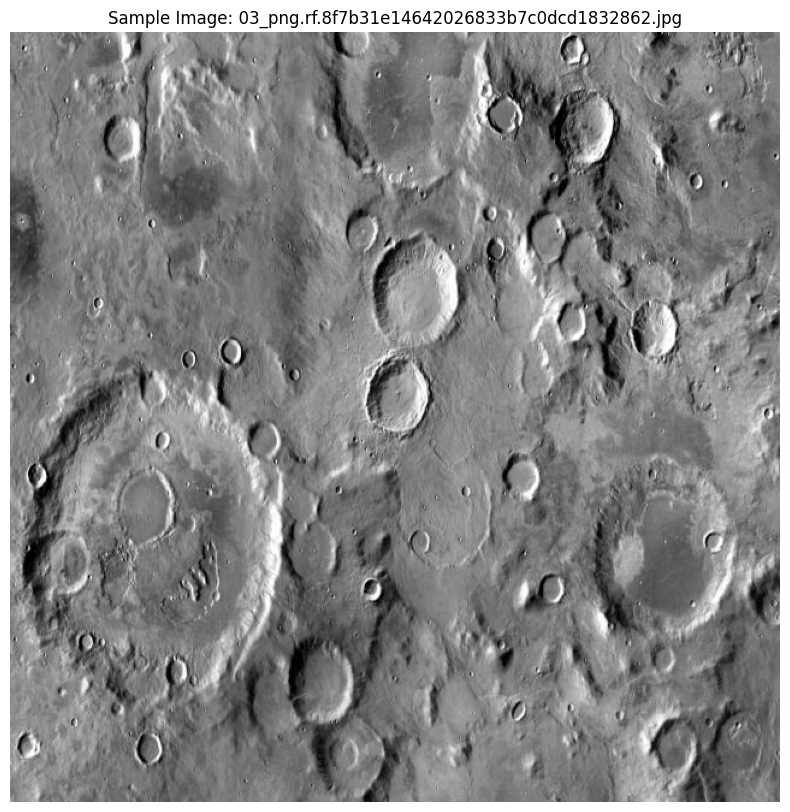

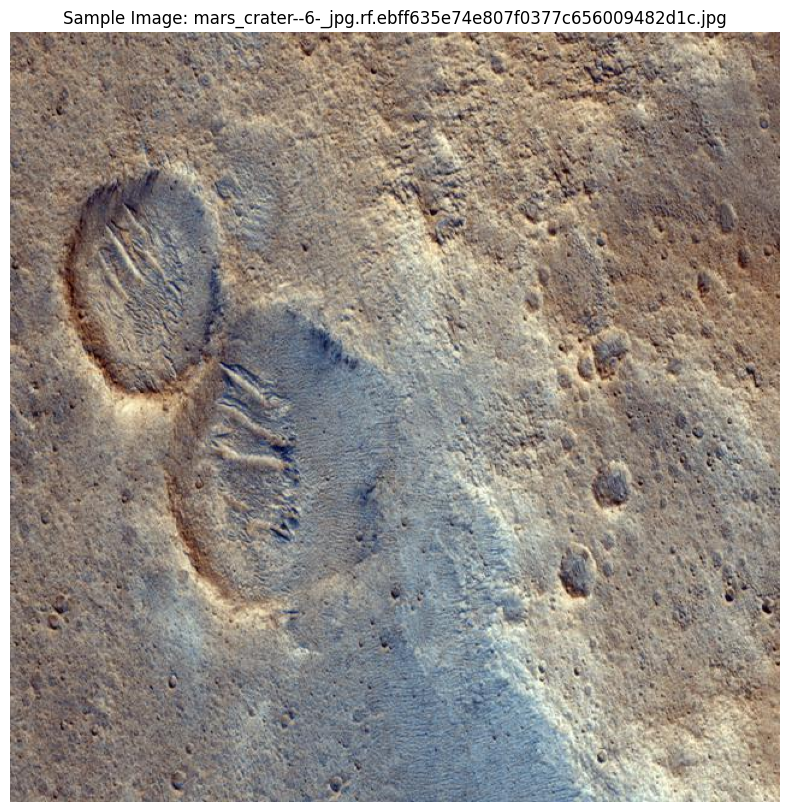

...

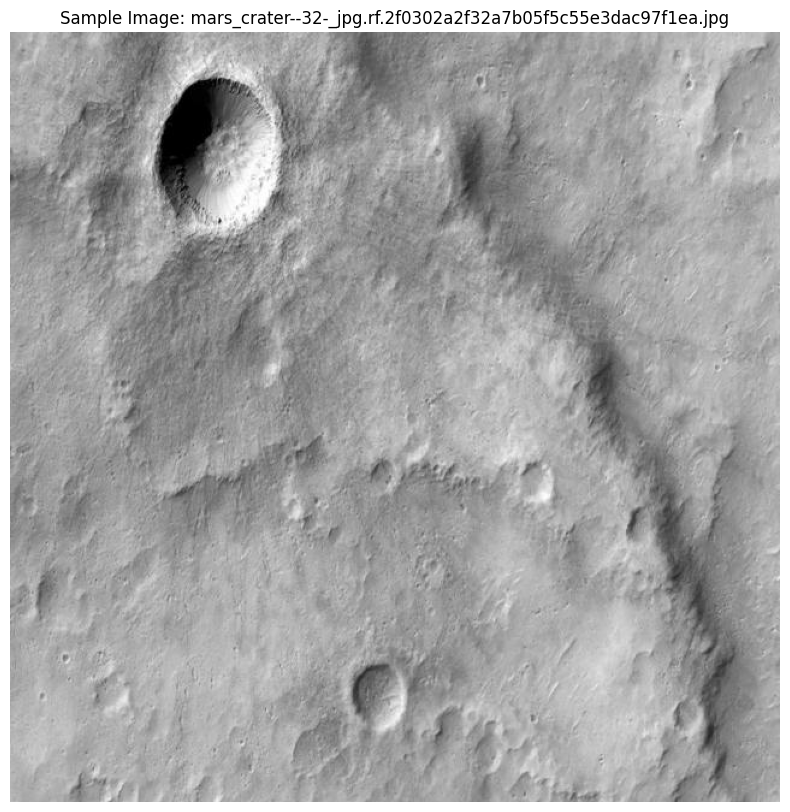

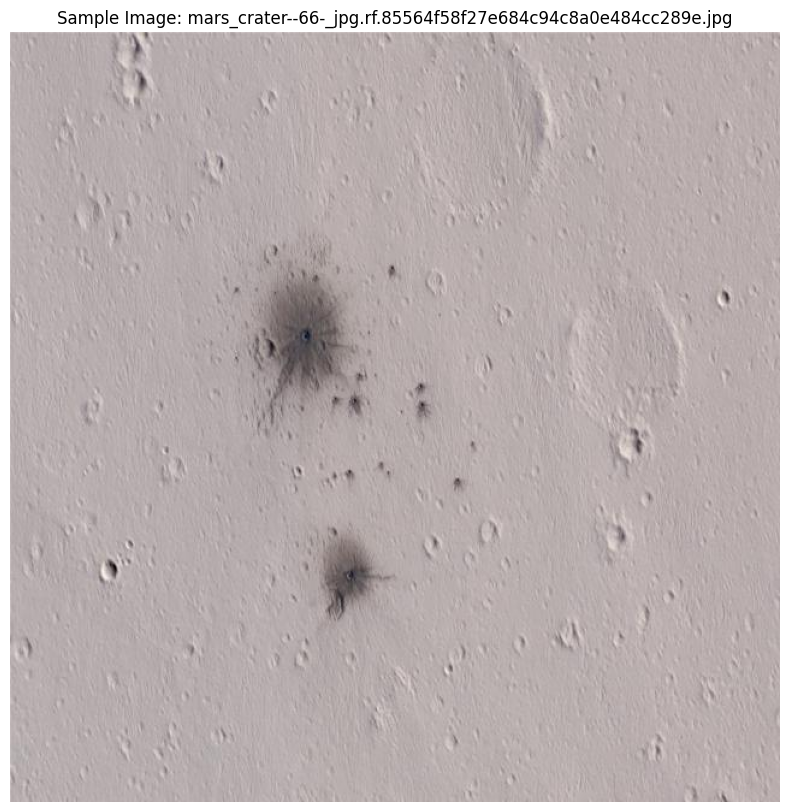

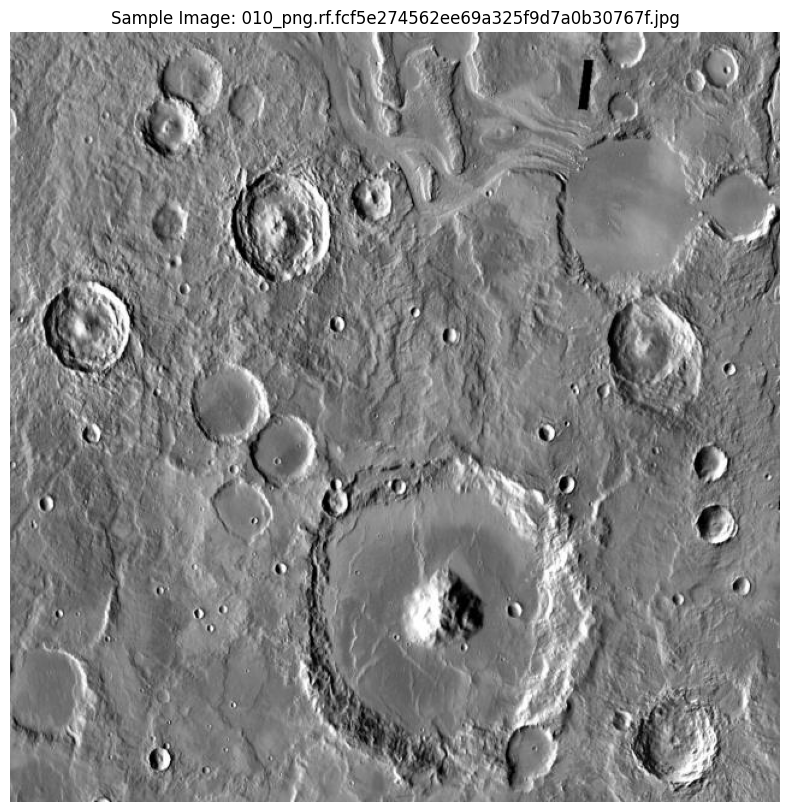

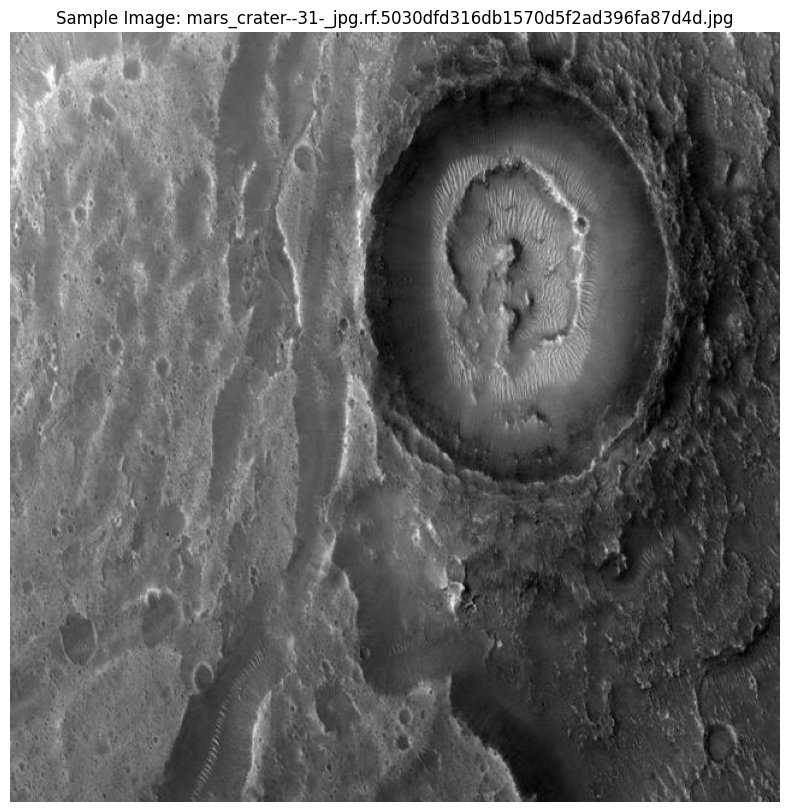

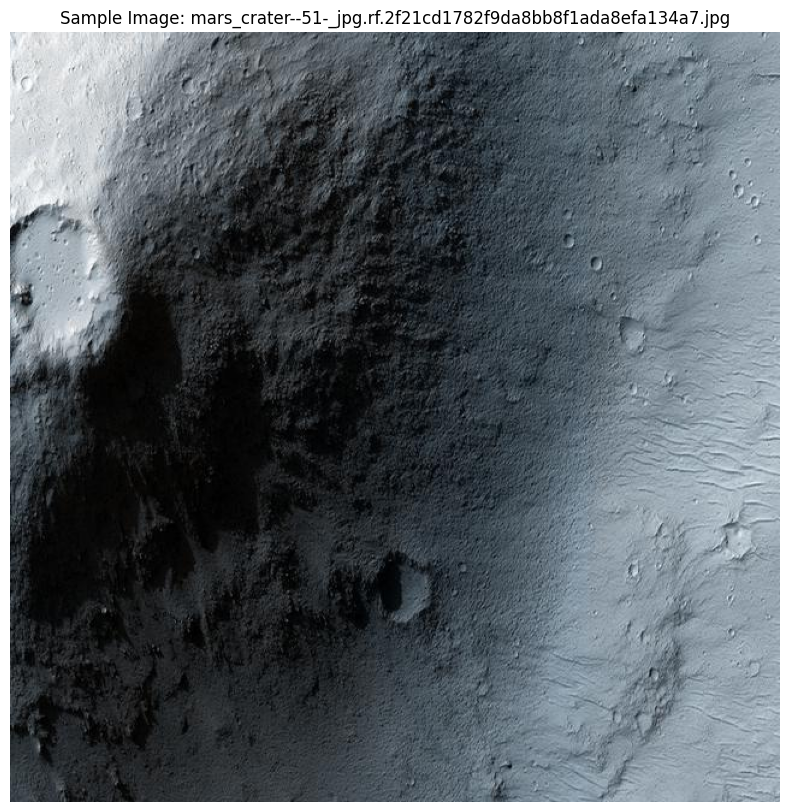

In [10]:
# Image Preprocessing and Visualization
def visualize_sample_images(image_path, label_df, n_samples=5):
    image_files = os.listdir(image_path)[:n_samples]
    for img_file in image_files:
        img_path = os.path.join(image_path, img_file)
        img = cv2.imread(img_path)
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

        fig, ax = plt.subplots(1, 1, figsize=(10, 10))
        ax.imshow(img)

        labels = label_df[label_df['file'] == img_file]
        for _, label in labels.iterrows():
            x_center = int(label['x_center'] * img.shape[1])
            y_center = int(label['y_center'] * img.shape[0])
            width = int(label['width'] * img.shape[1])
            height = int(label['height'] * img.shape[0])
            x_min = x_center - width // 2
            y_min = y_center - height // 2

            rect = plt.Rectangle((x_min, y_min), width, height, edgecolor='red', facecolor='none', linewidth=2)
            ax.add_patch(rect)

        plt.title(f'Sample Image: {img_file}')
        plt.axis('off')
        plt.show()

visualize_sample_images(train_img_path, train_labels)
visualize_sample_images(valid_img_path, valid_labels)
visualize_sample_images(test_img_path, test_labels)

In [11]:
# YOLOv8 Model Training and Evaluation
!pip install -q ultralytics
from ultralytics import YOLO

In [12]:
# Load the model
model = YOLO('yolov8n.pt')

In [14]:
# Train the model
model.train(data=data_yaml_path, epochs=50)

Ultralytics 8.3.18 🚀 Python-3.10.12 torch-2.4.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
engine/trainer: task=detect, mode=train, model=yolov8n.pt, data=/content/drive/My Drive/Datasets/craters/data.yaml, epochs=50, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train2, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, s

train: Scanning /content/drive/My Drive/Datasets/craters/train/labels... 98 images, 9 backgrounds, 0 corrupt: 100%|██████████| 98/98 [00:09<00:00, 10.71it/s]

train: New cache created: /content/drive/My Drive/Datasets/craters/train/labels.cache


albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))


/usr/local/lib/python3.10/dist-packages/albumentations/__init__.py:13: UserWarning:

A new version of Albumentations is available: 1.4.18 (you have 1.4.15). Upgrade using: pip install -U albumentations. To disable automatic update checks, set the environment variable NO_ALBUMENTATIONS_UPDATE to 1.

val: Scanning /content/drive/My Drive/Datasets/craters/valid/labels... 26 images, 2 backgrounds, 0 corrupt: 100%|██████████| 26/26 [00:13<00:00,  1.91it/s]

val: New cache created: /content/drive/My Drive/Datasets/craters/valid/labels.cache


Plotting labels to runs/detect/train2/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.002, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 2 dataloader workers
Logging results to runs/detect/train2
Starting training for 50 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/50      2.45G      1.766      3.427      1.387         17        640: 100%|██████████| 7/7 [00:04<00:00,  1.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.48s/it]

                   all         26        202     0.0109      0.421     0.0599     0.0236



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/50      2.27G      1.629      2.607      1.295         25        640: 100%|██████████| 7/7 [00:02<00:00,  2.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.92it/s]

                   all         26        202     0.0167      0.644       0.14     0.0801



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/50      2.35G      1.545      1.943      1.234         12        640: 100%|██████████| 7/7 [00:02<00:00,  2.77it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.66it/s]

                   all         26        202      0.021      0.812      0.253      0.153



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/50      2.37G      1.479      1.727      1.212          6        640: 100%|██████████| 7/7 [00:01<00:00,  5.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.30it/s]

                   all         26        202     0.0213      0.822      0.317      0.186



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/50      2.36G      1.497      1.563      1.209         37        640: 100%|██████████| 7/7 [00:01<00:00,  4.97it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.19it/s]

                   all         26        202          1     0.0963      0.331      0.212



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/50      2.36G      1.485      1.515      1.229         19        640: 100%|██████████| 7/7 [00:01<00:00,  4.94it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.46it/s]

                   all         26        202      0.845     0.0446      0.205      0.128



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/50       2.2G      1.475      1.929      1.257          7        640: 100%|██████████| 7/7 [00:01<00:00,  4.76it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.29it/s]

                   all         26        202      0.887      0.194      0.387      0.222



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/50      2.66G      1.483      1.503       1.22         19        640: 100%|██████████| 7/7 [00:01<00:00,  3.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.48it/s]

                   all         26        202      0.766      0.211      0.354      0.207



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/50      2.26G      1.448       1.43      1.208         33        640: 100%|██████████| 7/7 [00:02<00:00,  3.15it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.38it/s]

                   all         26        202      0.801      0.219      0.417      0.244



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/50      2.25G      1.597      1.743      1.289          4        640: 100%|██████████| 7/7 [00:01<00:00,  5.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.91it/s]

                   all         26        202      0.775      0.158      0.319      0.181



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/50      2.23G      1.549      1.624      1.266         10        640: 100%|██████████| 7/7 [00:01<00:00,  5.16it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.67it/s]

                   all         26        202      0.256      0.223      0.191     0.0979



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/50      2.28G      1.509      1.425      1.212         17        640: 100%|██████████| 7/7 [00:01<00:00,  4.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.47it/s]

                   all         26        202      0.135      0.272      0.118     0.0569



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/50      2.22G       1.48      1.501      1.241          6        640: 100%|██████████| 7/7 [00:01<00:00,  4.76it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.76it/s]

                   all         26        202      0.102      0.302     0.0956      0.046



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/50      2.31G      1.616      1.623      1.338          5        640: 100%|██████████| 7/7 [00:02<00:00,  3.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.15it/s]

                   all         26        202      0.126      0.406       0.11     0.0508



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/50      2.36G      1.489      1.407      1.201         14        640: 100%|██████████| 7/7 [00:02<00:00,  3.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.30it/s]

                   all         26        202      0.272        0.5      0.286      0.151



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/50      2.21G      1.486      1.321      1.243         21        640: 100%|██████████| 7/7 [00:01<00:00,  4.77it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.01it/s]

                   all         26        202      0.539       0.51      0.512      0.262



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/50      2.34G      1.418      1.414      1.192         19        640: 100%|██████████| 7/7 [00:01<00:00,  5.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.29it/s]

                   all         26        202      0.567      0.554      0.562      0.292



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/50      2.27G      1.385      1.319      1.182         23        640: 100%|██████████| 7/7 [00:01<00:00,  5.04it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.10it/s]

                   all         26        202      0.585      0.629      0.593        0.3



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/50       2.2G      1.465      1.261      1.239         14        640: 100%|██████████| 7/7 [00:01<00:00,  5.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.60it/s]

                   all         26        202      0.558      0.606      0.555      0.286



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/50      2.36G      1.315      1.288      1.184          7        640: 100%|██████████| 7/7 [00:01<00:00,  3.60it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.84it/s]

                   all         26        202       0.57      0.564      0.547      0.276



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      21/50      2.28G      1.462      1.247      1.192         15        640: 100%|██████████| 7/7 [00:02<00:00,  3.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.30it/s]

                   all         26        202      0.576      0.554      0.541       0.28



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      22/50      2.28G      1.389      1.212      1.182         12        640: 100%|██████████| 7/7 [00:01<00:00,  4.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.93it/s]

                   all         26        202      0.645      0.564      0.612      0.326



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      23/50      2.24G      1.426       1.46      1.261          3        640: 100%|██████████| 7/7 [00:01<00:00,  5.00it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.20it/s]

                   all         26        202      0.611      0.584      0.613      0.353



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      24/50      2.32G      1.388      1.294      1.168         23        640: 100%|██████████| 7/7 [00:01<00:00,  4.65it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.49it/s]

                   all         26        202      0.609      0.545      0.585      0.338



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      25/50      2.34G      1.308      1.201      1.163         14        640: 100%|██████████| 7/7 [00:01<00:00,  5.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.51it/s]

                   all         26        202      0.554      0.657      0.606      0.331



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      26/50      2.34G      1.269      1.101      1.162         18        640: 100%|██████████| 7/7 [00:02<00:00,  3.48it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.81it/s]

                   all         26        202      0.558      0.655      0.624      0.337



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      27/50       2.3G      1.399      1.242      1.161         23        640: 100%|██████████| 7/7 [00:02<00:00,  3.25it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.45it/s]

                   all         26        202       0.59      0.594      0.608      0.334



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      28/50      2.37G      1.386      1.222      1.118         12        640: 100%|██████████| 7/7 [00:01<00:00,  4.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.76it/s]

                   all         26        202      0.582      0.661      0.647      0.336



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      29/50      2.25G      1.416      1.239      1.212         15        640: 100%|██████████| 7/7 [00:01<00:00,  5.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.72it/s]

                   all         26        202      0.608      0.663      0.636       0.34



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      30/50      2.35G      1.342      1.148      1.218          6        640: 100%|██████████| 7/7 [00:01<00:00,  4.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.02it/s]

                   all         26        202      0.641      0.644       0.64       0.34



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      31/50      2.26G      1.274      1.118      1.127          9        640: 100%|██████████| 7/7 [00:01<00:00,  5.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.58it/s]

                   all         26        202      0.612      0.644      0.651      0.338



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      32/50      2.21G      1.273      1.051      1.125         24        640: 100%|██████████| 7/7 [00:01<00:00,  3.75it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.46it/s]

                   all         26        202      0.668      0.604      0.637      0.342



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      33/50      2.38G      1.271       1.09       1.09         36        640: 100%|██████████| 7/7 [00:02<00:00,  3.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.89it/s]

                   all         26        202       0.69      0.604       0.64      0.345



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      34/50      2.38G      1.233       1.03      1.114         21        640: 100%|██████████| 7/7 [00:01<00:00,  3.94it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.97it/s]

                   all         26        202      0.604      0.658      0.655      0.346



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      35/50      2.37G       1.26      1.058      1.088         11        640: 100%|██████████| 7/7 [00:01<00:00,  5.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.82it/s]

                   all         26        202      0.618      0.678      0.679      0.358



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      36/50       2.2G      1.384      1.105      1.149         11        640: 100%|██████████| 7/7 [00:01<00:00,  4.86it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.47it/s]

                   all         26        202      0.644      0.693      0.688      0.353



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      37/50      2.33G       1.18     0.9521      1.084         13        640: 100%|██████████| 7/7 [00:01<00:00,  5.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.38it/s]

                   all         26        202       0.68      0.673      0.694      0.372



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      38/50      2.26G      1.235      1.005       1.05         36        640: 100%|██████████| 7/7 [00:01<00:00,  4.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.49it/s]

                   all         26        202      0.705      0.693       0.73      0.396



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      39/50      2.24G       1.13     0.9265      1.045         25        640: 100%|██████████| 7/7 [00:02<00:00,  3.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.35it/s]

                   all         26        202      0.703      0.673      0.722      0.402



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      40/50      2.26G      1.256      1.058      1.086         11        640: 100%|██████████| 7/7 [00:02<00:00,  3.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.95it/s]

                   all         26        202      0.673      0.705      0.709      0.395


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      41/50      2.37G      1.305       1.18      1.096         19        640: 100%|██████████| 7/7 [00:03<00:00,  2.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.06it/s]

                   all         26        202      0.654      0.701      0.703      0.384



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      42/50      2.27G      1.313      1.103      1.184          4        640: 100%|██████████| 7/7 [00:01<00:00,  4.60it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.10it/s]

                   all         26        202      0.706      0.594       0.66      0.374



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      43/50      2.23G      1.185      1.006      1.103         16        640: 100%|██████████| 7/7 [00:01<00:00,  4.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.71it/s]

                   all         26        202      0.687      0.609      0.664      0.374



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      44/50      2.25G      1.229      1.148      1.124          5        640: 100%|██████████| 7/7 [00:01<00:00,  3.76it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.58it/s]

                   all         26        202      0.722      0.589      0.653      0.357



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      45/50      2.28G      1.157     0.9423      1.021         23        640: 100%|██████████| 7/7 [00:01<00:00,  4.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.68it/s]

                   all         26        202      0.638      0.629      0.647      0.354



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      46/50      2.28G      1.268      1.062      1.062         12        640: 100%|██████████| 7/7 [00:01<00:00,  5.40it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.70it/s]

                   all         26        202      0.631      0.644      0.652      0.346



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      47/50      2.26G      1.205      1.001      1.088          8        640: 100%|██████████| 7/7 [00:01<00:00,  5.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.57it/s]

                   all         26        202      0.634      0.636      0.654      0.347



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      48/50      2.31G      1.165     0.9526      1.066          9        640: 100%|██████████| 7/7 [00:01<00:00,  5.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.05it/s]

                   all         26        202      0.636      0.657      0.665      0.361



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      49/50       2.2G      1.152     0.9126       1.07         22        640: 100%|██████████| 7/7 [00:01<00:00,  4.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.94it/s]

                   all         26        202      0.636      0.649      0.672      0.366



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      50/50      2.27G      1.146     0.8846      1.042         22        640: 100%|██████████| 7/7 [00:01<00:00,  3.80it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.53it/s]

                   all         26        202      0.643      0.653      0.676       0.37



50 epochs completed in 0.046 hours.
Optimizer stripped from runs/detect/train2/weights/last.pt, 6.3MB
Optimizer stripped from runs/detect/train2/weights/best.pt, 6.3MB

Validating runs/detect/train2/weights/best.pt...
Ultralytics 8.3.18 🚀 Python-3.10.12 torch-2.4.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
Model summary (fused): 168 layers, 3,005,843 parameters, 0 gradients, 8.1 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.53it/s]


                   all         26        202      0.703      0.673      0.723      0.401
Speed: 0.2ms preprocess, 2.7ms inference, 0.0ms loss, 2.9ms postprocess per image
Results saved to runs/detect/train2


ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x7f750a7aa470>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,
          0.048048, 

In [15]:
# Evaluate the model
results = model.val()

# Save the trained model
model.save('/content/drive/My Drive/Datasets/craters/best_model.pt')

Ultralytics 8.3.18 🚀 Python-3.10.12 torch-2.4.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
Model summary (fused): 168 layers, 3,005,843 parameters, 0 gradients, 8.1 GFLOPs


val: Scanning /content/drive/My Drive/Datasets/craters/valid/labels.cache... 26 images, 2 backgrounds, 0 corrupt: 100%|██████████| 26/26 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.83it/s]


                   all         26        202      0.707      0.673      0.723      0.399
Speed: 0.3ms preprocess, 14.8ms inference, 0.0ms loss, 2.7ms postprocess per image
Results saved to runs/detect/train22



image 1/1 /content/drive/My Drive/Datasets/craters/test/images/mars_crater--32-_jpg.rf.2f0302a2f32a7b05f5c55e3dac97f1ea.jpg: 640x640 7 class_0s, 7.2ms
Speed: 1.9ms preprocess, 7.2ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)


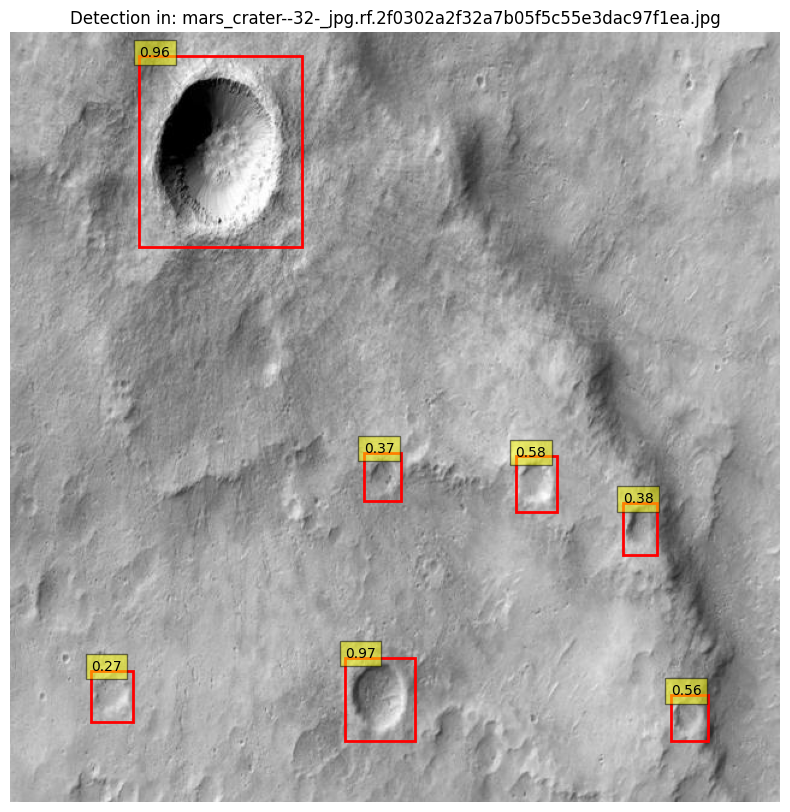


image 1/1 /content/drive/My Drive/Datasets/craters/test/images/mars_crater--66-_jpg.rf.85564f58f27e684c94c8a0e484cc289e.jpg: 640x640 1 class_0, 10.4ms
Speed: 2.2ms preprocess, 10.4ms inference, 4.1ms postprocess per image at shape (1, 3, 640, 640)


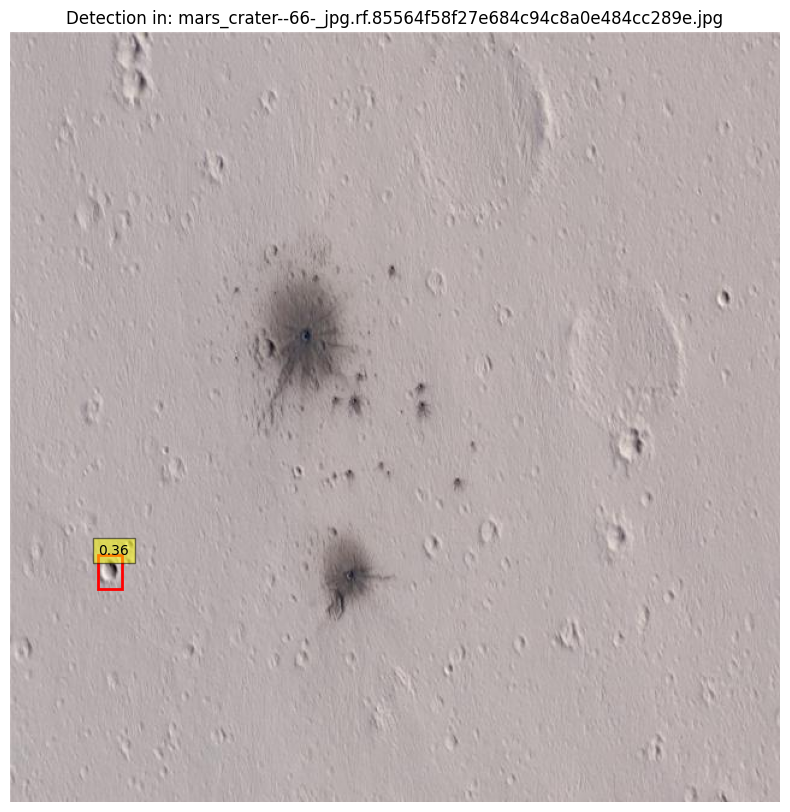


image 1/1 /content/drive/My Drive/Datasets/craters/test/images/010_png.rf.fcf5e274562ee69a325f9d7a0b30767f.jpg: 640x640 34 class_0s, 7.9ms
Speed: 2.2ms preprocess, 7.9ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)


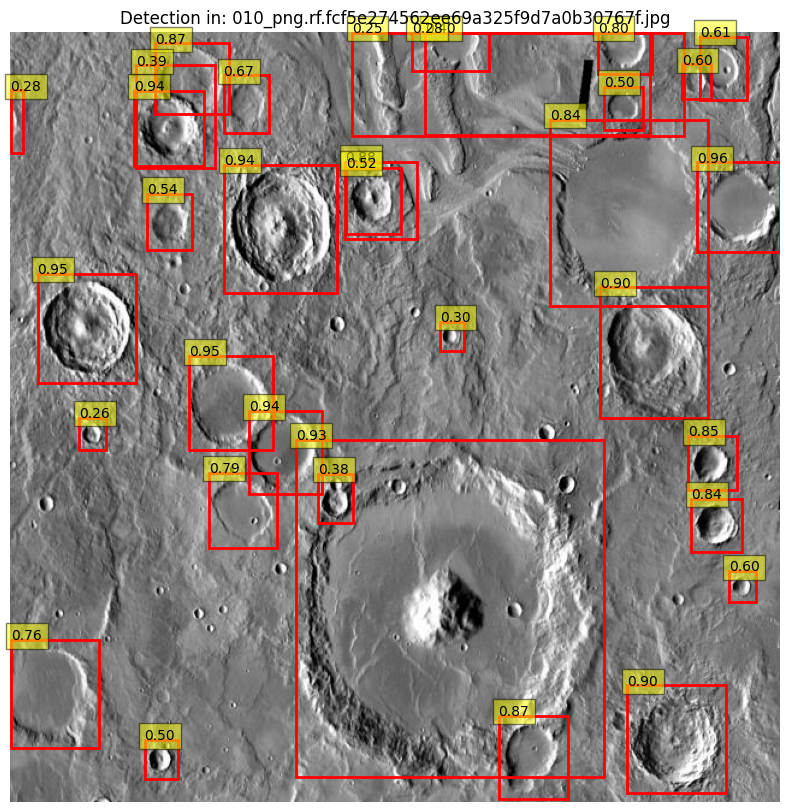


image 1/1 /content/drive/My Drive/Datasets/craters/test/images/mars_crater--31-_jpg.rf.5030dfd316db1570d5f2ad396fa87d4d.jpg: 640x640 5 class_0s, 9.3ms
Speed: 2.5ms preprocess, 9.3ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 640)


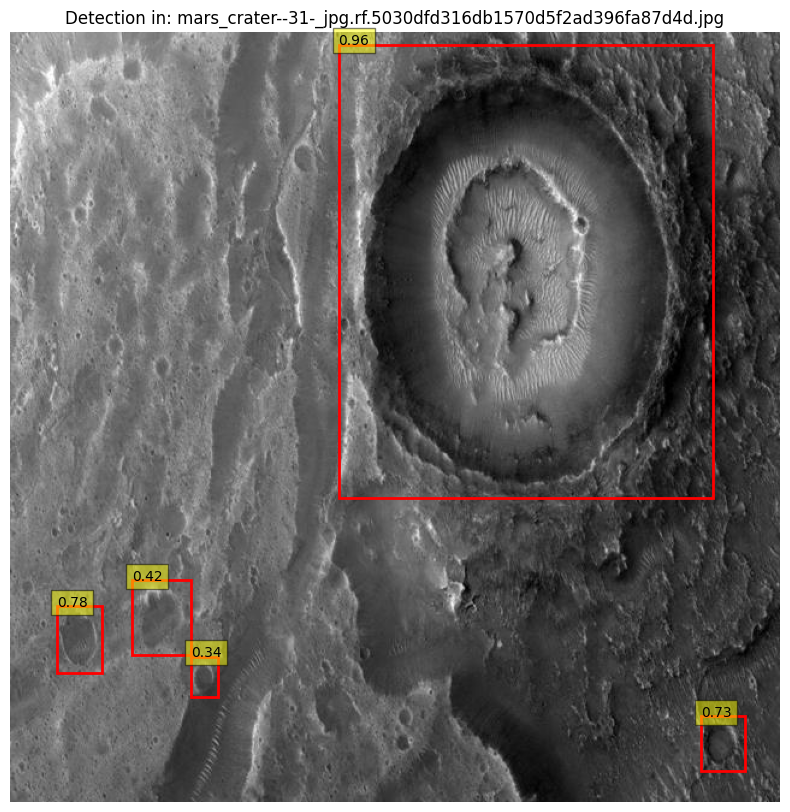


image 1/1 /content/drive/My Drive/Datasets/craters/test/images/mars_crater--51-_jpg.rf.2f21cd1782f9da8bb8f1ada8efa134a7.jpg: 640x640 4 class_0s, 10.7ms
Speed: 2.2ms preprocess, 10.7ms inference, 2.4ms postprocess per image at shape (1, 3, 640, 640)


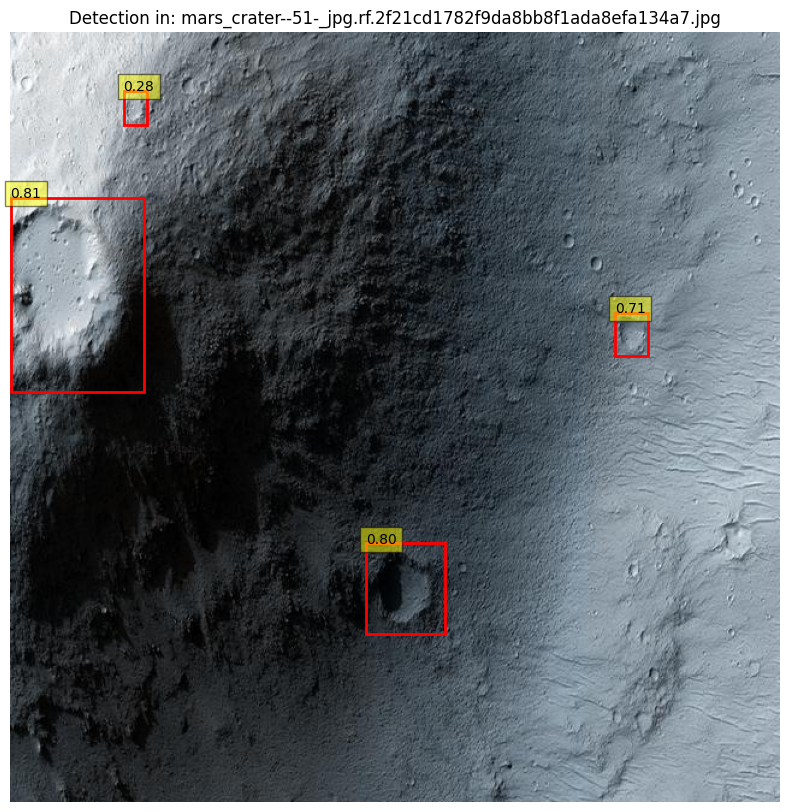


image 1/1 /content/drive/My Drive/Datasets/craters/test/images/mars_crater--12-_jpg.rf.26060e7ca4ca8781bcaf011b9b70b7db.jpg: 640x640 3 class_0s, 8.6ms
Speed: 2.3ms preprocess, 8.6ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)


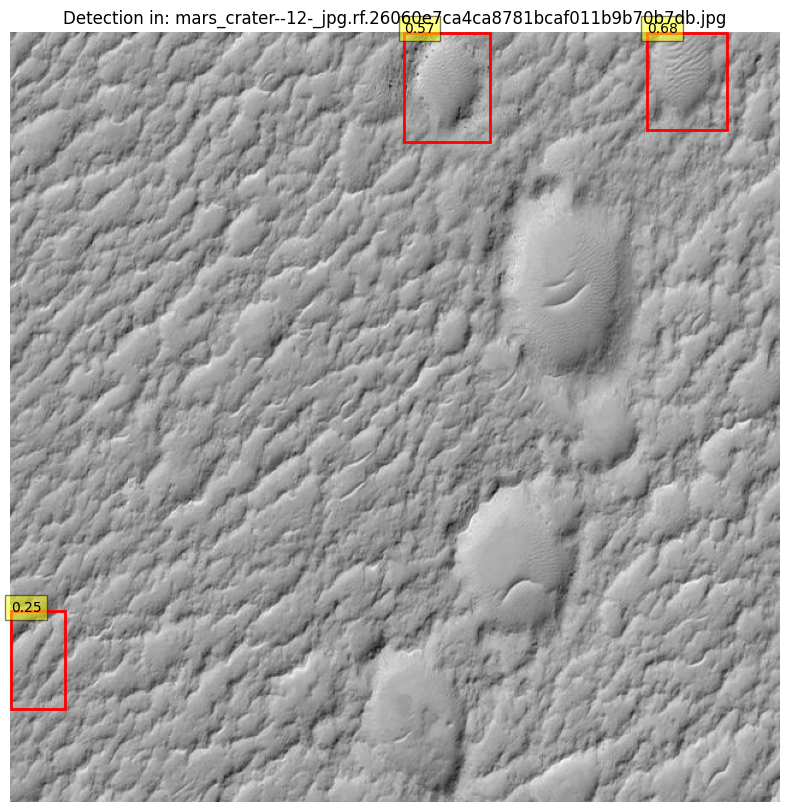


image 1/1 /content/drive/My Drive/Datasets/craters/test/images/mars_crater--100-_jpg.rf.a2ad5867efb2d73e86d9d980ca40a9fe.jpg: 640x640 6 class_0s, 8.9ms
Speed: 2.3ms preprocess, 8.9ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)


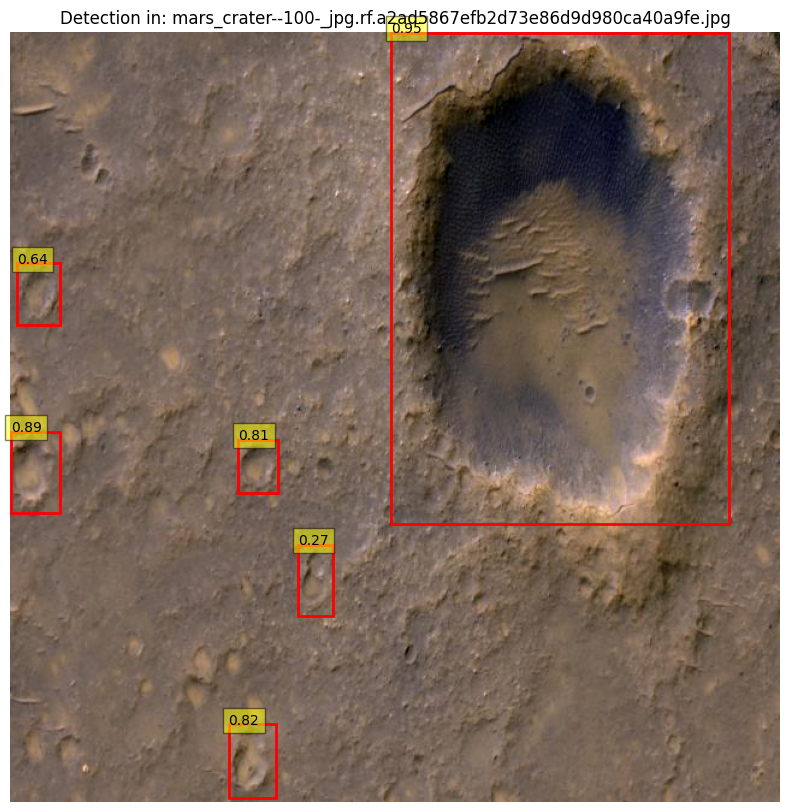


image 1/1 /content/drive/My Drive/Datasets/craters/test/images/mars_crater--46-_jpg.rf.369e88a43859f97a595d2091746600f4.jpg: 640x640 1 class_0, 8.3ms
Speed: 2.3ms preprocess, 8.3ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)


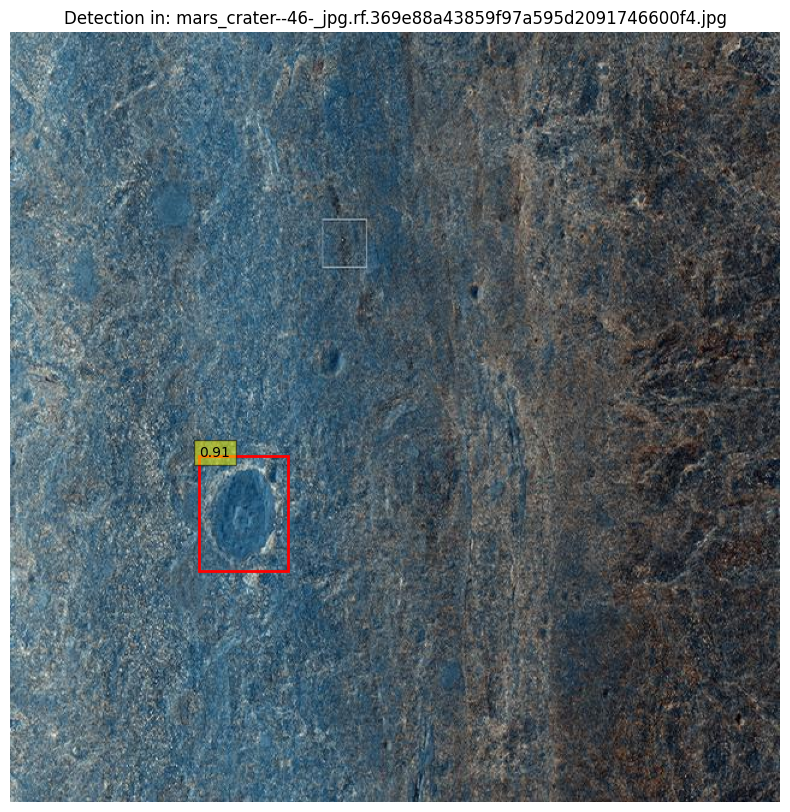


image 1/1 /content/drive/My Drive/Datasets/craters/test/images/04_png.rf.81a7d6cbeb9dc09e5a8ecd40e185fc92.jpg: 640x640 22 class_0s, 13.5ms
Speed: 2.5ms preprocess, 13.5ms inference, 1.8ms postprocess per image at shape (1, 3, 640, 640)


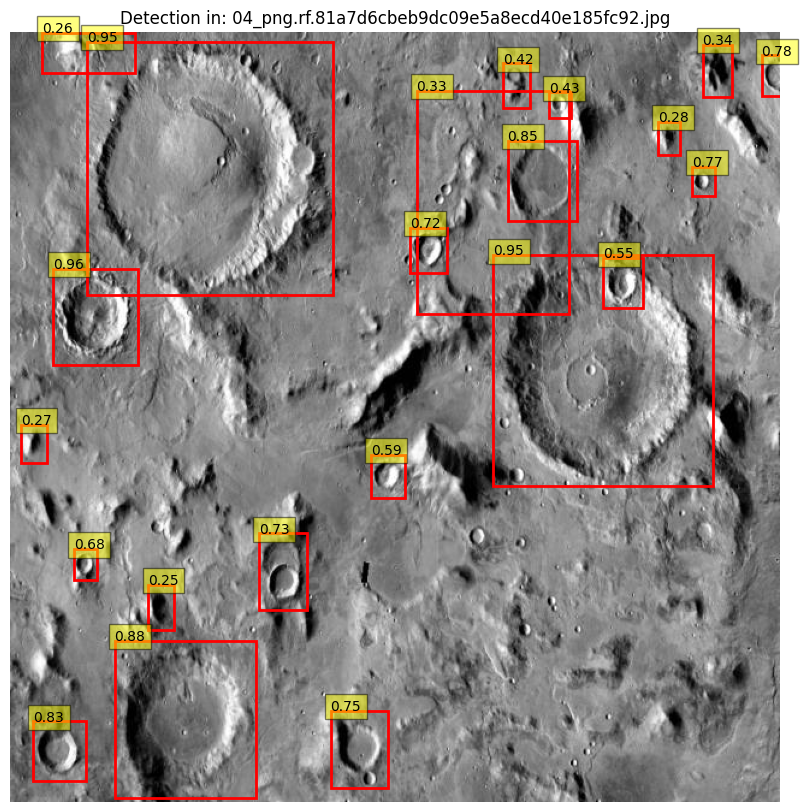


image 1/1 /content/drive/My Drive/Datasets/craters/test/images/mars_crater--117-_jpg.rf.b412b6593d102c5f9dda7bce79bb815c.jpg: 640x640 15 class_0s, 10.4ms
Speed: 2.3ms preprocess, 10.4ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)


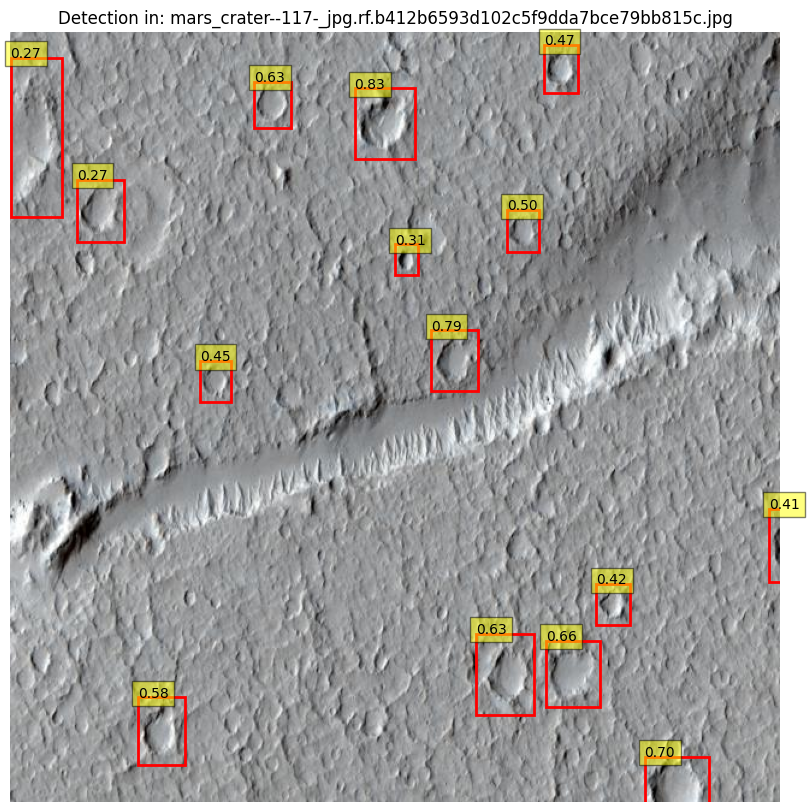

Model training, evaluation, and sample visualization completed. The trained model is saved at '/content/drive/My Drive/Datasets/craters/best_model.pt'.


In [16]:
# Visualize sample detections
def visualize_detections(model, image_path, n_samples=10):
    image_files = os.listdir(image_path)[:n_samples]
    for img_file in image_files:
        img_path = os.path.join(image_path, img_file)
        img = cv2.imread(img_path)
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        results = model(img_path)

        fig, ax = plt.subplots(1, 1, figsize=(10, 10))
        ax.imshow(img)

        for result in results[0].boxes:
            x_min, y_min, x_max, y_max = result.xyxy[0].tolist()
            conf = result.conf[0].item()
            rect = plt.Rectangle((x_min, y_min), x_max - x_min, y_max - y_min, edgecolor='red', facecolor='none', linewidth=2)
            ax.add_patch(rect)
            ax.text(x_min, y_min, f'{conf:.2f}', bbox=dict(facecolor='yellow', alpha=0.5))

        plt.title(f'Detection in: {img_file}')
        plt.axis('off')
        plt.show()

visualize_detections(model, test_img_path)

print("Model training, evaluation, and sample visualization completed. The trained model is saved at '/content/drive/My Drive/Datasets/craters/best_model.pt'.")